In [1]:
import pandas as pd
df=pd.read_csv("C:/Users/LAKSHMI CHARISHMA/Documents/AQI prediction/data/cleaned/cleaned_dataset.csv")

In [2]:
df.head()

,temperature_celsius,wind_kph,wind_degree,pressure_mb,precip_mm,humidity,cloud,visibility_km,uv_index,gust_kph,...,air_quality_Nitrogen_dioxide,air_quality_Sulphur_dioxide,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index,hour,day_of_week,month,is_weekend,part_of_day
0,26.6,13.3,338,1012.0,0.0,24,30,10.0,7.0,15.3,...,1.1,0.2,8.40,26.6,1,13,3,5,0,afternoon
1,19.0,11.2,320,1012.0,0.1,94,75,10.0,5.0,18.4,...,0.9,0.1,1.10,2.0,1,10,3,5,0,morning
2,23.0,15.1,280,1011.0,0.0,29,0,10.0,5.0,22.3,...,65.1,13.4,10.40,18.4,1,9,3,5,0,morning
3,6.3,11.9,215,1007.0,0.3,61,100,2.0,2.0,13.7,...,1.6,0.2,0.70,0.9,1,10,3,5,0,morning
4,26.0,13.0,150,1011.0,0.0,89,50,10.0,8.0,20.2,...,72.7,31.5,177.97,262.3,5,9,3,5,0,morning


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 90838 entries, 0 to 90837
Data columns (total 22 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   temperature_celsius           90838 non-null  float64
 1   wind_kph                      90838 non-null  float64
 2   wind_degree                   90838 non-null  int64  
 3   pressure_mb                   90838 non-null  float64
 4   precip_mm                     90838 non-null  float64
 5   humidity                      90838 non-null  int64  
 6   cloud                         90838 non-null  int64  
 7   visibility_km                 90838 non-null  float64
 8   uv_index                      90838 non-null  float64
 9   gust_kph                      90838 non-null  float64
 10  air_quality_Carbon_Monoxide   90838 non-null  float64
 11  air_quality_Ozone             90838 non-null  float64
 12  air_quality_Nitrogen_dioxide  90838 non-null  float64
 13  a

SAVING THE PLOTS INTO THE REPORTS DIRECTORY

In [4]:
import os
import matplotlib.pyplot as plt
import plotly.graph_objects as go

# Create Reports folder if it doesn't exist
os.makedirs("Reports", exist_ok=True)

def auto_save_plot(plot_obj=None, default_name="plot"):
    """
    Automatically saves matplotlib/seaborn or plotly plots to Reports/ folder.
    File name is taken from the plot title if available.
    """
    file_name = default_name
    
    # --- Case 1: Matplotlib / Seaborn ---
    if isinstance(plot_obj, plt.Figure) or plot_obj is None:
        fig = plt.gcf()  # get current matplotlib figure
        title = fig._suptitle.get_text() if fig._suptitle else None
        if title is None and fig.axes and fig.axes[0].get_title():
            title = fig.axes[0].get_title()
        if title:
            file_name = title.replace(" ", "_").lower()
        path = f"Reports/{file_name}.png"
        fig.savefig(path, bbox_inches="tight")
        print(f"✅ Saved Matplotlib figure: {path}")
    
    # --- Case 2: Plotly ---
    elif isinstance(plot_obj, go.Figure):
        title = plot_obj.layout.title.text if plot_obj.layout.title.text else None
        if title:
            file_name = title.replace(" ", "_").lower()
        path = f"Reports/{file_name}.png"
        plot_obj.write_image(path)
        print(f"✅ Saved Plotly figure: {path}")
    
    else:
        print("⚠️ Unsupported plot object type.")


In [5]:
!pip install --upgrade kaleido


[notice] A new release of pip is available: 24.0 -> 25.2
[notice] To update, run: python.exe -m pip install --upgrade pip


DATA VISUALISATIONS

CORRELATION

In [6]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import warnings
warnings.filterwarnings('ignore')

plt.style.use('seaborn-v0_8')
sns.set_palette("viridis")

# 1. Correlation Heatmap (Most Important)

# Select numerical columns for correlation
numerical_cols = ['temperature_celsius', 'wind_kph', 'wind_degree', 'pressure_mb', 
                     'precip_mm', 'humidity', 'cloud', 'visibility_km', 'uv_index', 
                     'gust_kph', 'air_quality_Nitrogen_dioxide', 'air_quality_Sulphur_dioxide',
                     'air_quality_PM2.5', 'air_quality_PM10', 'air_quality_us-epa-index']
    
corr_matrix = df[numerical_cols].corr()
    
fig = px.imshow(corr_matrix,
                   title="Correlation Heatmap of Weather and Air Quality Parameters",
                   aspect="auto",
                   color_continuous_scale='RdBu_r',
                   zmin=-1, zmax=1)
    
fig.update_layout(width=800, height=700)
fig.show()
auto_save_plot(fig) 

✅ Saved Plotly figure: Reports/correlation_heatmap_of_weather_and_air_quality_parameters.png


In [7]:
# 2. Time Series Analysis of AQI Components
fig = make_subplots(rows=2, cols=2, 
                       subplot_titles=('PM2.5 Over Time', 'PM10 Over Time',
                                      'NO2 Over Time', 'SO2 Over Time'))
    
# Add traces
fig.add_trace(go.Scatter(x=df.index, y=df['air_quality_PM2.5'], 
                        name='PM2.5', mode='lines'), row=1, col=1)
fig.add_trace(go.Scatter(x=df.index, y=df['air_quality_PM10'], 
                        name='PM10', mode='lines'), row=1, col=2)
fig.add_trace(go.Scatter(x=df.index, y=df['air_quality_Nitrogen_dioxide'], 
                        name='NO2', mode='lines'), row=2, col=1)
fig.add_trace(go.Scatter(x=df.index, y=df['air_quality_Sulphur_dioxide'], 
                        name='SO2', mode='lines'), row=2, col=2)

fig.update_layout(height=600, width=1000, 
                 title_text="Time Series of Air Quality Parameters")
fig.show()
auto_save_plot(fig)

✅ Saved Plotly figure: Reports/time_series_of_air_quality_parameters.png


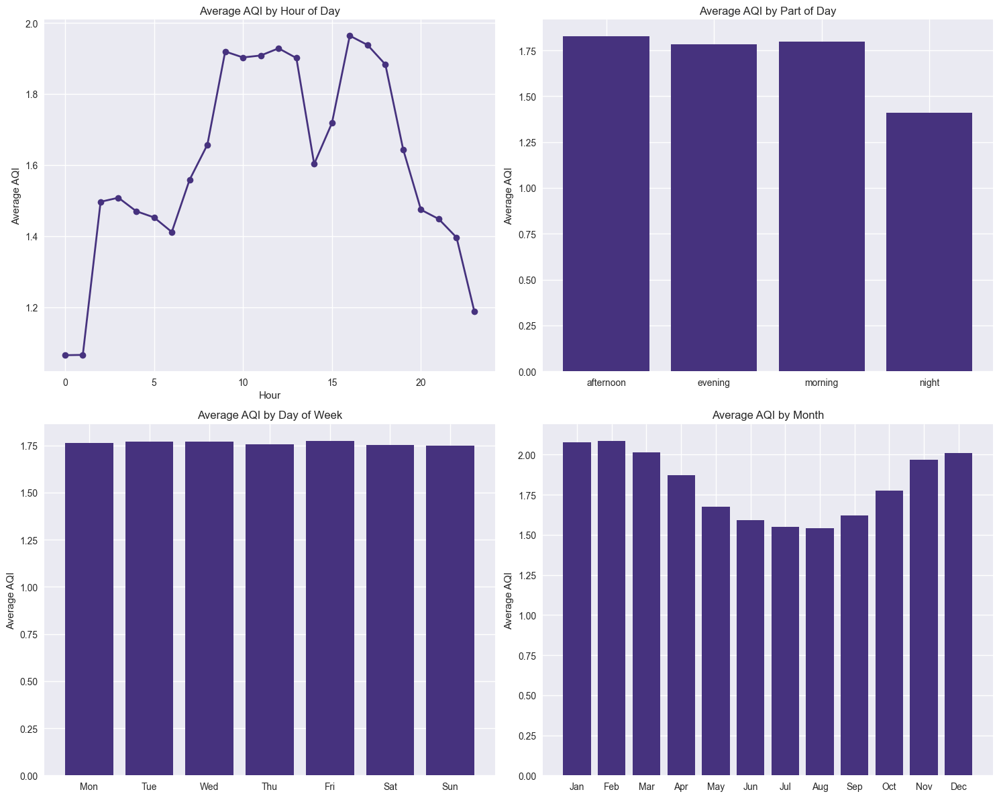

✅ Saved Matplotlib figure: Reports/plot.png


<Figure size 800x550 with 0 Axes>

In [8]:
# 3. AQI Distribution by Time Factor
fig, axes = plt.subplots(2, 2, figsize=(15, 12))
    
# AQI by hour
hourly_avg = df.groupby('hour')['air_quality_us-epa-index'].mean()
axes[0,0].plot(hourly_avg.index, hourly_avg.values, marker='o', linewidth=2)
axes[0,0].set_title('Average AQI by Hour of Day')
axes[0,0].set_xlabel('Hour')
axes[0,0].set_ylabel('Average AQI')

# AQI by part of day
part_of_day_avg = df.groupby('part_of_day')['air_quality_us-epa-index'].mean()
axes[0,1].bar(part_of_day_avg.index, part_of_day_avg.values)
axes[0,1].set_title('Average AQI by Part of Day')
axes[0,1].set_ylabel('Average AQI')
 
# AQI by day of week
day_avg = df.groupby('day_of_week')['air_quality_us-epa-index'].mean()
days = ['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun']
axes[1,0].bar(days, day_avg.values)
axes[1,0].set_title('Average AQI by Day of Week')
axes[1,0].set_ylabel('Average AQI')

# AQI by month
month_avg = df.groupby('month')['air_quality_us-epa-index'].mean()
months = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
axes[1,1].bar(months[:len(month_avg)], month_avg.values)
axes[1,1].set_title('Average AQI by Month')
axes[1,1].set_ylabel('Average AQI')
    
plt.tight_layout()
plt.show()
auto_save_plot(None)

SCATTER PLOTS

In [9]:
# 4. Scatter Plots: Weather vs AQI Parameters
fig = make_subplots(rows=2, cols=2,
                    subplot_titles=('Temperature vs PM2.5', 'Humidity vs PM2.5',
                                    'Wind Speed vs PM2.5', 'Pressure vs PM2.5'))

fig.add_trace(go.Scatter(x=df['temperature_celsius'], y=df['air_quality_PM2.5'],
                        mode='markers', name='Temp vs PM2.5'), row=1, col=1)
fig.add_trace(go.Scatter(x=df['humidity'], y=df['air_quality_PM2.5'],
                        mode='markers', name='Humidity vs PM2.5'), row=1, col=2)
fig.add_trace(go.Scatter(x=df['wind_kph'], y=df['air_quality_PM2.5'],
                        mode='markers', name='Wind vs PM2.5'), row=2, col=1)
fig.add_trace(go.Scatter(x=df['pressure_mb'], y=df['air_quality_PM2.5'],
                        mode='markers', name='Pressure vs PM2.5'), row=2, col=2)

fig.update_layout(height=600, width=1000, 
                    title_text="Weather Parameters vs PM2.5 Concentration")
fig.show()
auto_save_plot(fig)

✅ Saved Plotly figure: Reports/weather_parameters_vs_pm2.5_concentration.png


HISTOGRAMS

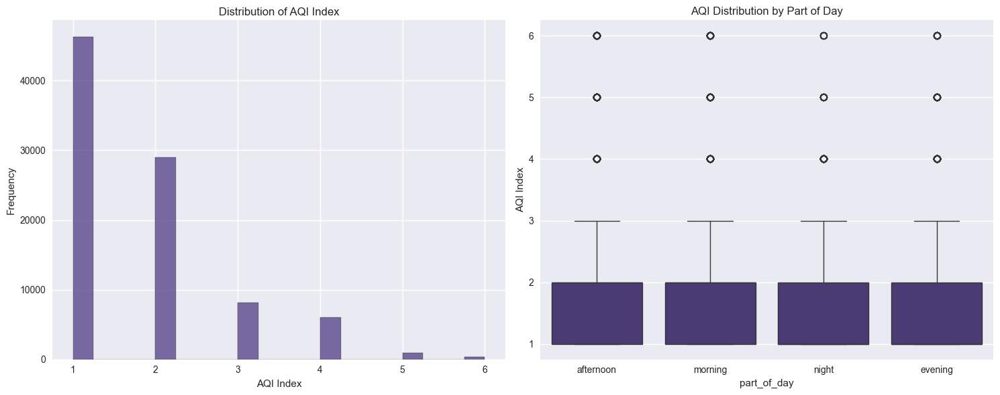

✅ Saved Matplotlib figure: Reports/plot.png


In [10]:
# 5. Distribution of AQI Index
fig, axes = plt.subplots(1, 2, figsize=(15, 6))

# Histogram
axes[0].hist(df['air_quality_us-epa-index'], bins=20, alpha=0.7, edgecolor='black')
axes[0].set_title('Distribution of AQI Index')
axes[0].set_xlabel('AQI Index')
axes[0].set_ylabel('Frequency')

# Box plot by part of day
sns.boxplot(x='part_of_day', y='air_quality_us-epa-index', data=df, ax=axes[1])
axes[1].set_title('AQI Distribution by Part of Day')
axes[1].set_ylabel('AQI Index')

plt.tight_layout()
plt.show()
auto_save_plot(None) 
plt.close()

PAIR PLOTS

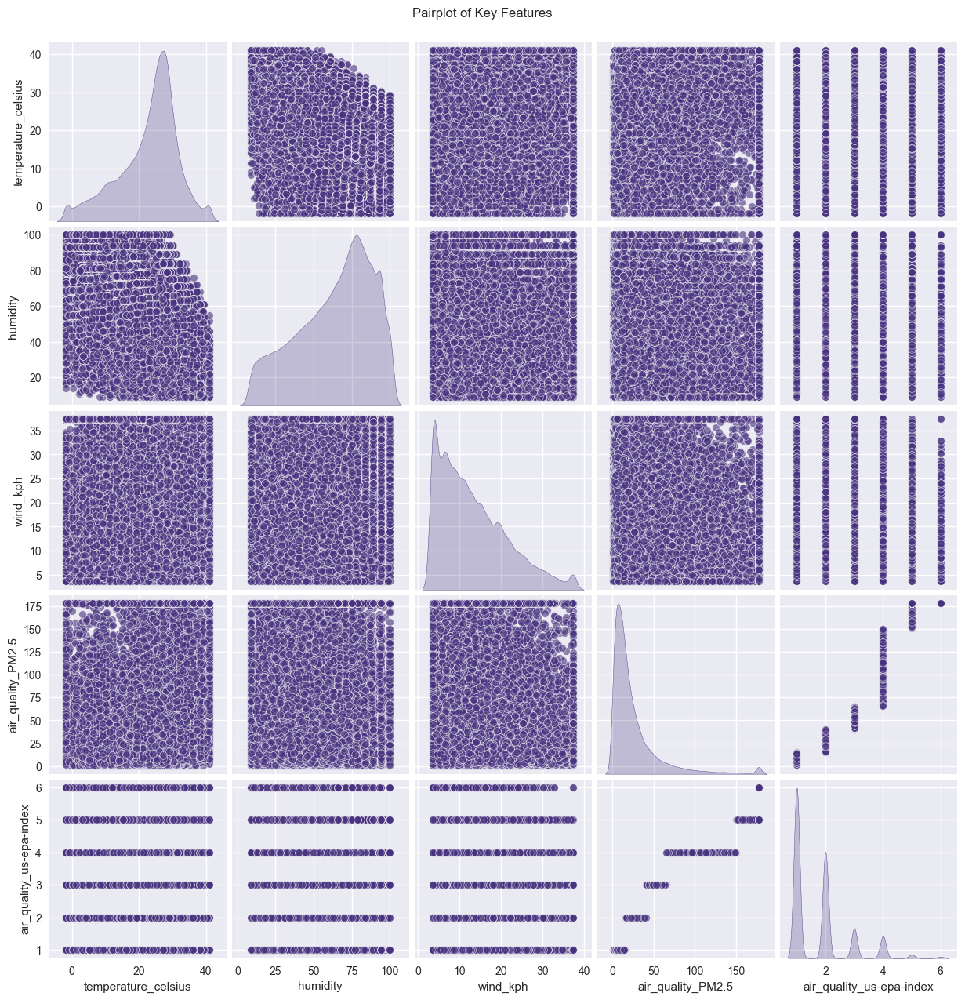

✅ Saved Matplotlib figure: Reports/plot.png


In [11]:
# 6. Pairplot for Key Features
# Select key features for pairplot
key_features = ['temperature_celsius', 'humidity', 'wind_kph', 
                'air_quality_PM2.5', 'air_quality_us-epa-index']

sns.pairplot(df[key_features], diag_kind='kde', plot_kws={'alpha': 0.6})
plt.suptitle('Pairplot of Key Features', y=1.02)
plt.show()
auto_save_plot(None) 
plt.close()

SCATTER PLOTS

In [12]:
# 7. Wind Analysis for Pollution Dispersion
fig = px.scatter_polar(df, r='wind_kph', theta='wind_degree',
                        color='air_quality_PM2.5',
                        title='Wind Direction and Speed vs PM2.5 Concentration',
                        color_continuous_scale='viridis')
fig.update_layout(width=700, height=600)
fig.show()
auto_save_plot(fig)


✅ Saved Plotly figure: Reports/wind_direction_and_speed_vs_pm2.5_concentration.png


In [13]:
# Pollution Rose Diagram (Wind Direction vs Pollution)
# Create wind direction bins
wind_bins = [0, 45, 90, 135, 180, 225, 270, 315, 360]
wind_labels = ['N', 'NE', 'E', 'SE', 'S', 'SW', 'W', 'NW']
df['wind_direction'] = pd.cut(df['wind_degree'], bins=wind_bins, labels=wind_labels)

# Calculate average pollution by wind direction
wind_pollution = df.groupby('wind_direction').agg({
    'air_quality_PM2.5': 'mean',
    'air_quality_PM10': 'mean',
    'air_quality_Nitrogen_dioxide': 'mean'
}).reset_index()

fig = go.Figure()

fig.add_trace(go.Barpolar(
    r=wind_pollution['air_quality_PM2.5'],
    theta=wind_pollution['wind_direction'],
    name='PM2.5',
    marker_color='rgb(106,81,163)'
))

fig.add_trace(go.Barpolar(
    r=wind_pollution['air_quality_PM10'],
    theta=wind_pollution['wind_direction'],
    name='PM10',
    marker_color='rgb(50,136,189)'
))

fig.add_trace(go.Barpolar(
    r=wind_pollution['air_quality_Nitrogen_dioxide'],
    theta=wind_pollution['wind_direction'],
    name='NO2',
    marker_color='rgb(202,0,32)'
))

fig.update_layout(
    title='Pollution Concentration by Wind Direction',
    font_size=12,
    legend_font_size=12,
    polar=dict(
        radialaxis=dict(
            visible=True,
            range=[0, max(wind_pollution[['air_quality_PM2.5', 'air_quality_PM10', 
                                        'air_quality_Nitrogen_dioxide']].max())]
        )),
    width=700,
    height=500
)

fig.show()
auto_save_plot(fig)

WARNING	Thread(Thread-14 (run)) choreographer.browser_async:browser_async.py:_close()- Resorting to unclean kill browser.


✅ Saved Plotly figure: Reports/pollution_concentration_by_wind_direction.png


HEAT MAP

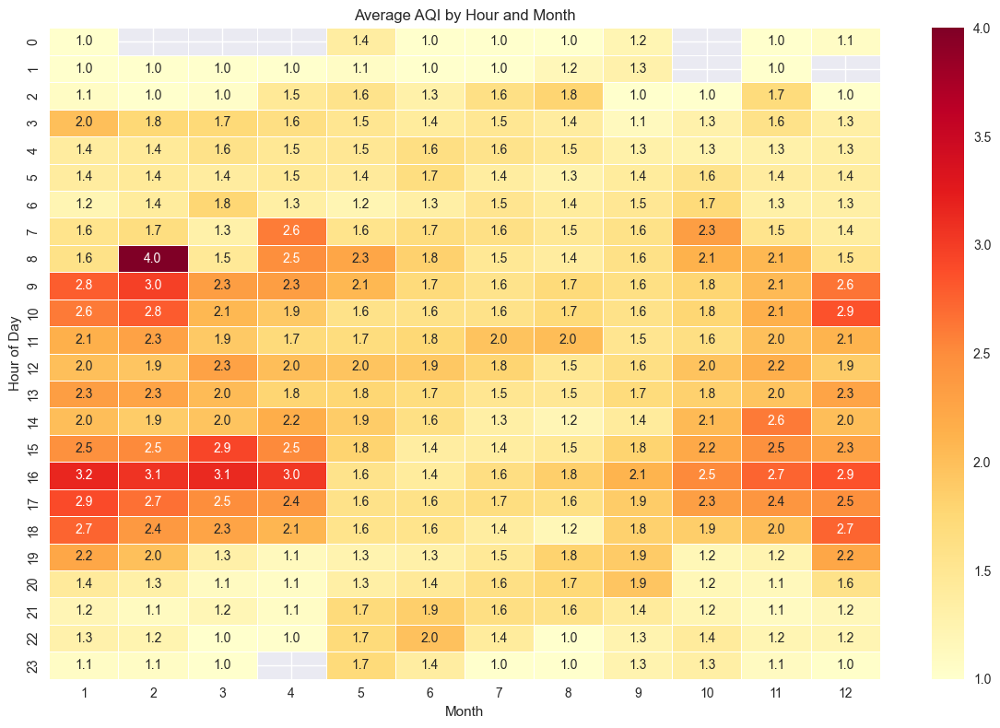

✅ Saved Matplotlib figure: Reports/plot.png


In [14]:
#Heatmap of AQI by Hour and Month
# Create pivot table for heatmap
heatmap_data = df.pivot_table(
    values='air_quality_us-epa-index', 
    index='hour', 
    columns='month', 
    aggfunc='mean'
)

plt.figure(figsize=(12, 8))
sns.heatmap(heatmap_data, cmap='YlOrRd', annot=True, fmt='.1f', linewidths=0.5)
plt.title('Average AQI by Hour and Month')
plt.xlabel('Month')
plt.ylabel('Hour of Day')
plt.tight_layout()
plt.show()
auto_save_plot(None) 
plt.close()

SCATTER PLOT

In [15]:
# 3D Scatter Plot of Key Parameters
fig = px.scatter_3d(
    df, 
    x='temperature_celsius', 
    y='humidity', 
    z='air_quality_PM2.5',
    color='air_quality_us-epa-index',
    size='wind_kph',
    hover_data=['part_of_day'],
    title='3D Relationship: Temperature, Humidity, PM2.5 and AQI',
    color_continuous_scale='viridis'
)

fig.update_layout(width=900, height=700)
fig.show()
auto_save_plot(None) 
plt.close()

✅ Saved Matplotlib figure: Reports/plot.png


VIOLIN PLOT

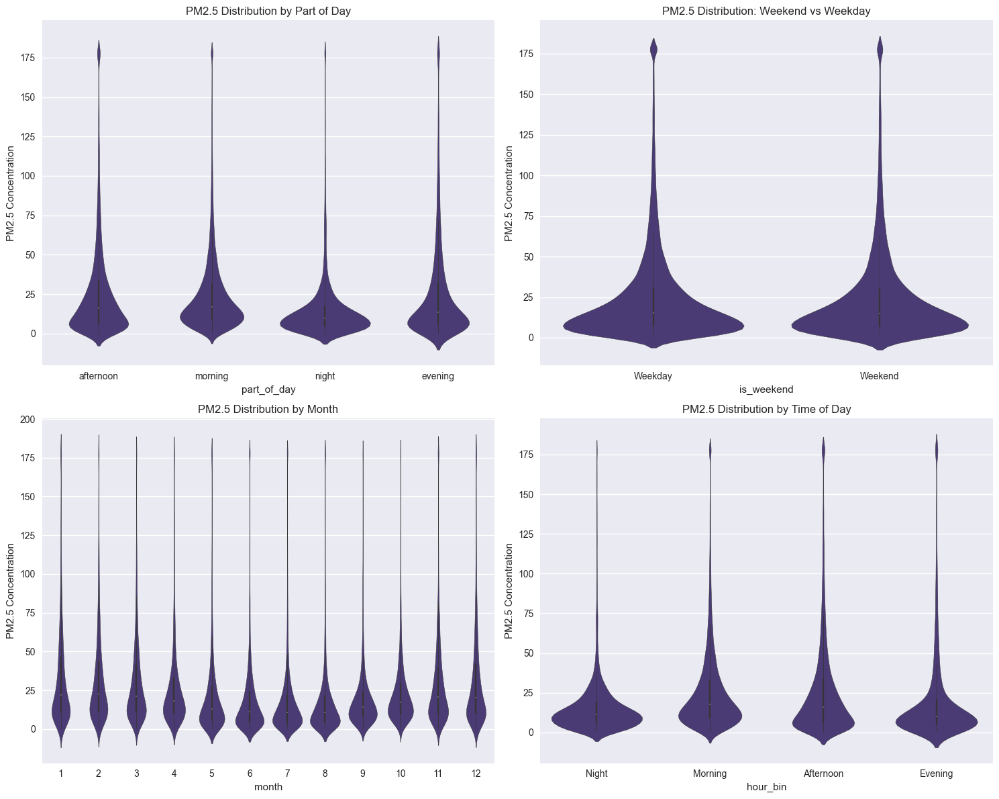

✅ Saved Matplotlib figure: Reports/plot.png


In [16]:
#Violin Plots for Pollution by Time Categories
fig, axes = plt.subplots(2, 2, figsize=(15, 12))

# Violin plot by part of day
sns.violinplot(x='part_of_day', y='air_quality_PM2.5', data=df, ax=axes[0,0])
axes[0,0].set_title('PM2.5 Distribution by Part of Day')
axes[0,0].set_ylabel('PM2.5 Concentration')

# Violin plot by weekend
sns.violinplot(x='is_weekend', y='air_quality_PM2.5', data=df, ax=axes[0,1])
axes[0,1].set_title('PM2.5 Distribution: Weekend vs Weekday')
axes[0,1].set_ylabel('PM2.5 Concentration')
axes[0,1].set_xticklabels(['Weekday', 'Weekend'])

# Violin plot by month
month_order = sorted(df['month'].unique())
sns.violinplot(x='month', y='air_quality_PM2.5', data=df, order=month_order, ax=axes[1,0])
axes[1,0].set_title('PM2.5 Distribution by Month')
axes[1,0].set_ylabel('PM2.5 Concentration')

# Violin plot by hour (binned)
df['hour_bin'] = pd.cut(df['hour'], bins=4, labels=['Night', 'Morning', 'Afternoon', 'Evening'])
sns.violinplot(x='hour_bin', y='air_quality_PM2.5', data=df, ax=axes[1,1])
axes[1,1].set_title('PM2.5 Distribution by Time of Day')
axes[1,1].set_ylabel('PM2.5 Concentration')

plt.tight_layout()
plt.show()
auto_save_plot(None) 
plt.close()

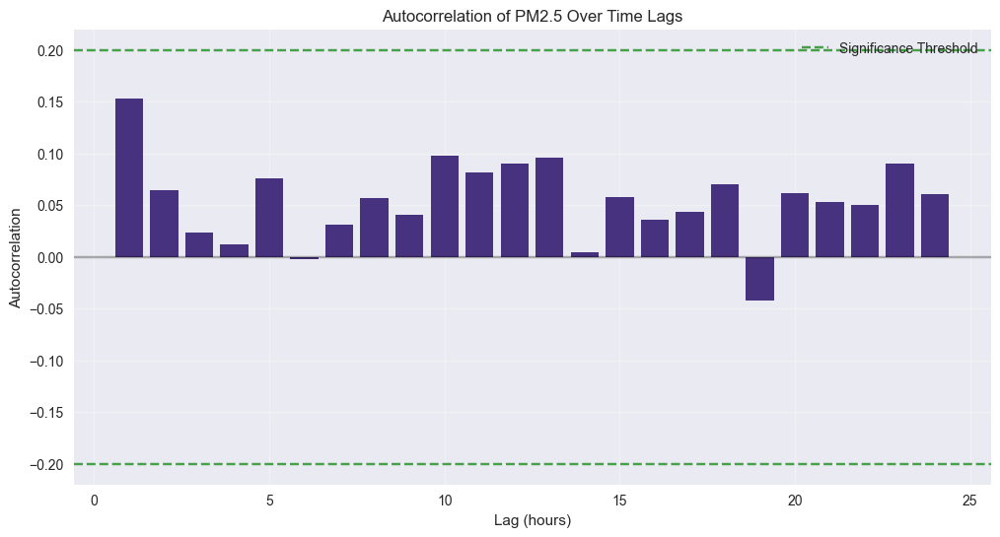

✅ Saved Matplotlib figure: Reports/plot.png


In [17]:
#Lag Analysis for Time Series Components
# Create lag features for PM2.5
for lag in [1, 2, 3, 6, 12, 24]:
    df[f'PM2.5_lag_{lag}'] = df['air_quality_PM2.5'].shift(lag)

# Calculate autocorrelation
lags = range(1, 25)
autocorrelations = [df['air_quality_PM2.5'].autocorr(lag) for lag in lags]

plt.figure(figsize=(12, 6))
plt.bar(lags, autocorrelations)
plt.axhline(y=0, color='black', linestyle='-', alpha=0.3)
plt.axhline(y=0.2, color='green', linestyle='--', alpha=0.7, label='Significance Threshold')
plt.axhline(y=-0.2, color='green', linestyle='--', alpha=0.7)
plt.title('Autocorrelation of PM2.5 Over Time Lags')
plt.xlabel('Lag (hours)')
plt.ylabel('Autocorrelation')
plt.legend()
plt.grid(True, alpha=0.3)
plt.show()
auto_save_plot(None) 
plt.close()

In [18]:
#Interactive Parallel Coordinates Plot
# Select features for parallel coordinates
features = ['temperature_celsius', 'humidity', 'wind_kph', 'pressure_mb',
            'air_quality_PM2.5', 'air_quality_Nitrogen_dioxide', 'air_quality_us-epa-index']

fig = px.parallel_coordinates(
    df[features], 
    color='air_quality_us-epa-index',
    color_continuous_scale=px.colors.diverging.Tealrose,
    title='Parallel Coordinates Plot of Weather and Air Quality Parameters'
)

fig.update_layout(width=1000, height=600)
fig.show()
auto_save_plot(fig)

✅ Saved Plotly figure: Reports/parallel_coordinates_plot_of_weather_and_air_quality_parameters.png


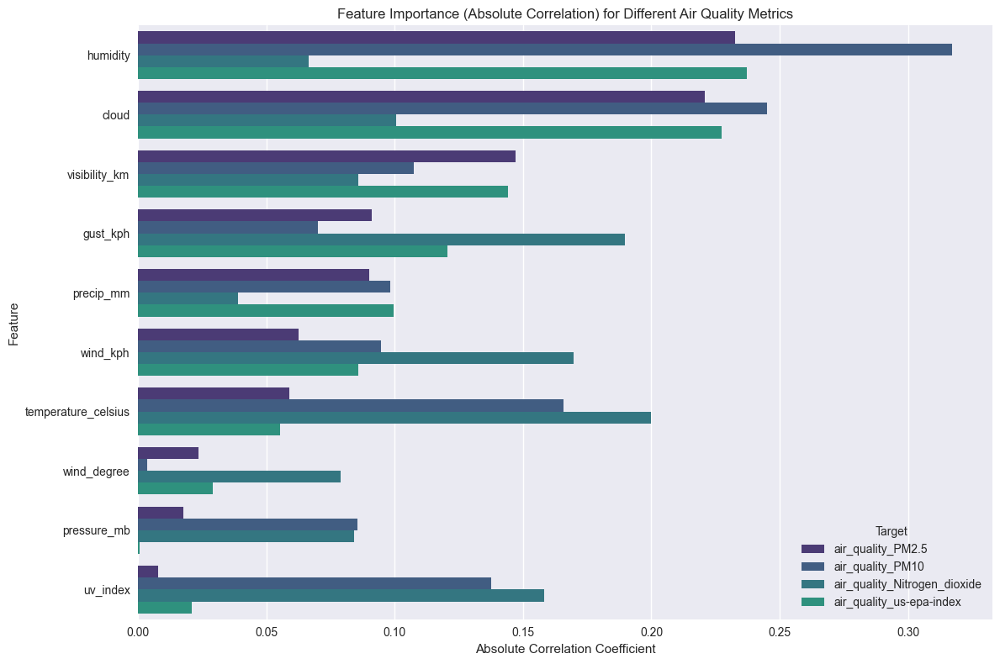

✅ Saved Matplotlib figure: Reports/plot.png


In [19]:
#Feature Importance Analysis (using correlation)
# Calculate correlation with target variables
target_vars = ['air_quality_PM2.5', 'air_quality_PM10', 
                'air_quality_Nitrogen_dioxide', 'air_quality_us-epa-index']

feature_cols = ['temperature_celsius', 'wind_kph', 'wind_degree', 'pressure_mb',
                'precip_mm', 'humidity', 'cloud', 'visibility_km', 'uv_index', 'gust_kph']

importance_data = []
for target in target_vars:
    correlations = df[feature_cols].corrwith(df[target]).abs().sort_values(ascending=False)
    for feature, corr in correlations.items():
        importance_data.append({'Feature': feature, 'Correlation': corr, 'Target': target})

importance_df = pd.DataFrame(importance_data)

plt.figure(figsize=(12, 8))
sns.barplot(x='Correlation', y='Feature', hue='Target', data=importance_df)
plt.title('Feature Importance (Absolute Correlation) for Different Air Quality Metrics')
plt.xlabel('Absolute Correlation Coefficient')
plt.tight_layout()
plt.show()
auto_save_plot(None) 
plt.close()